<a href="https://colab.research.google.com/github/atheendre130505/gans_monet/blob/main/monet_DCgan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import zipfile, os

for fname in ['photo.zip', 'monet.zip']:
    with zipfile.ZipFile(fname, 'r') as zip_ref:
        zip_ref.extractall('/content/dataset')
print(os.listdir('/content/dataset'))


['monet_jpg', 'photo_jpg']


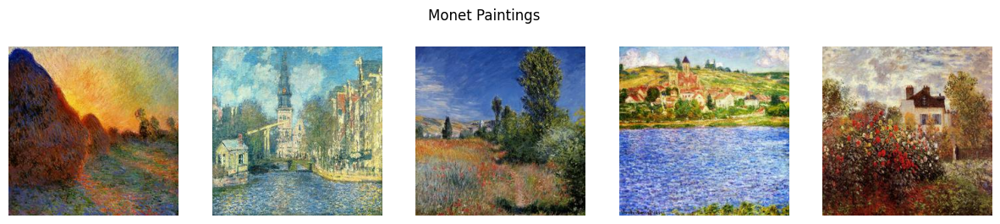

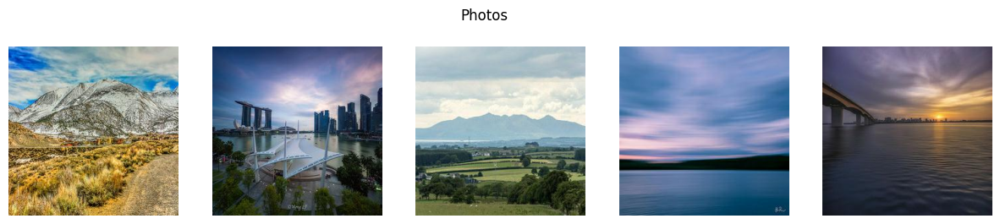

In [2]:
import matplotlib.pyplot as plt
import cv2
import random
from glob import glob

monet_paths = glob('/content/dataset/monet_jpg/*')
photo_paths = glob('/content/dataset/photo_jpg/*')

def show_samples(img_paths, title, n=5):
    plt.figure(figsize=(15,3))
    for i, path in enumerate(random.sample(img_paths, n)):
        img = cv2.imread(path)[:,:,::-1]
        plt.subplot(1,n,i+1)
        plt.imshow(img)
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

show_samples(monet_paths, "Monet Paintings")
show_samples(photo_paths, "Photos")


In [3]:
# Build on your existing code
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader

# Define image preprocessing
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])  # Normalize to [-1, 1]
])

# Create custom dataset class for Monet images
class MonetDataset(Dataset):
    def __init__(self, image_paths, transform=None):
        self.image_paths = image_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx])
        if self.transform:
            image = self.transform(image)
        return image


In [5]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision.utils import save_image


In [6]:
class DCGANGenerator(nn.Module):
    def __init__(self, latent_dim=100, img_channels=3, feature_maps=64):
        super(DCGANGenerator, self).__init__()
        self.net = nn.Sequential(
            # Input: latent_dim x 1 x 1
            nn.ConvTranspose2d(latent_dim, feature_maps * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(feature_maps * 8),
            nn.ReLU(True),

            # State: (feature_maps*8) x 4 x 4
            nn.ConvTranspose2d(feature_maps * 8, feature_maps * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps * 4),
            nn.ReLU(True),

            # State: (feature_maps*4) x 8 x 8
            nn.ConvTranspose2d(feature_maps * 4, feature_maps * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps * 2),
            nn.ReLU(True),

            # State: (feature_maps*2) x 16 x 16
            nn.ConvTranspose2d(feature_maps * 2, feature_maps, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps),
            nn.ReLU(True),

            # State: (feature_maps) x 32 x 32
            nn.ConvTranspose2d(feature_maps, img_channels, 4, 2, 1, bias=False),
            nn.Tanh()
            # Output: img_channels x 64 x 64 (change output size if needed)
        )

    def forward(self, x):
        return self.net(x)


In [7]:
class DCGANDiscriminator(nn.Module):
    def __init__(self, img_channels=3, feature_maps=64):
        super(DCGANDiscriminator, self).__init__()
        self.net = nn.Sequential(
            # Input: img_channels x 64 x 64
            nn.Conv2d(img_channels, feature_maps, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # State: (feature_maps) x 32 x 32
            nn.Conv2d(feature_maps, feature_maps * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # State: (feature_maps*2) x 16 x 16
            nn.Conv2d(feature_maps * 2, feature_maps * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # State: (feature_maps*4) x 8 x 8
            nn.Conv2d(feature_maps * 4, feature_maps * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(feature_maps * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # State: (feature_maps*8) x 4 x 4
            nn.Conv2d(feature_maps * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.net(x).view(-1)


Using device: cpu
Dataset size: 300
Number of batches: 5
Batch shape: torch.Size([64, 3, 64, 64])
Generator parameters: 3,576,704
Discriminator parameters: 2,765,568
Starting DCGAN training...
Epoch [1/100], Step [0/5], D Loss: 1.6374, G Loss: 6.6334
Epoch [1/100] - Avg G Loss: 6.3962, Avg D Loss: 1.0144
Epoch [2/100], Step [0/5], D Loss: 0.6052, G Loss: 7.5830
Epoch [2/100] - Avg G Loss: 8.4438, Avg D Loss: 0.6198
Epoch [3/100], Step [0/5], D Loss: 0.2362, G Loss: 8.5718
Epoch [3/100] - Avg G Loss: 9.2036, Avg D Loss: 0.3575
Epoch [4/100], Step [0/5], D Loss: 0.1982, G Loss: 9.6596
Epoch [4/100] - Avg G Loss: 10.7214, Avg D Loss: 0.2850
Epoch [5/100], Step [0/5], D Loss: 0.4234, G Loss: 16.0860
Epoch [5/100] - Avg G Loss: 17.0494, Avg D Loss: 0.7682
Epoch [6/100], Step [0/5], D Loss: 0.3609, G Loss: 18.4152
Epoch [6/100] - Avg G Loss: 16.6011, Avg D Loss: 0.4078
Epoch [7/100], Step [0/5], D Loss: 0.0821, G Loss: 10.0053
Epoch [7/100] - Avg G Loss: 10.3894, Avg D Loss: 0.1928
Epoch [8/

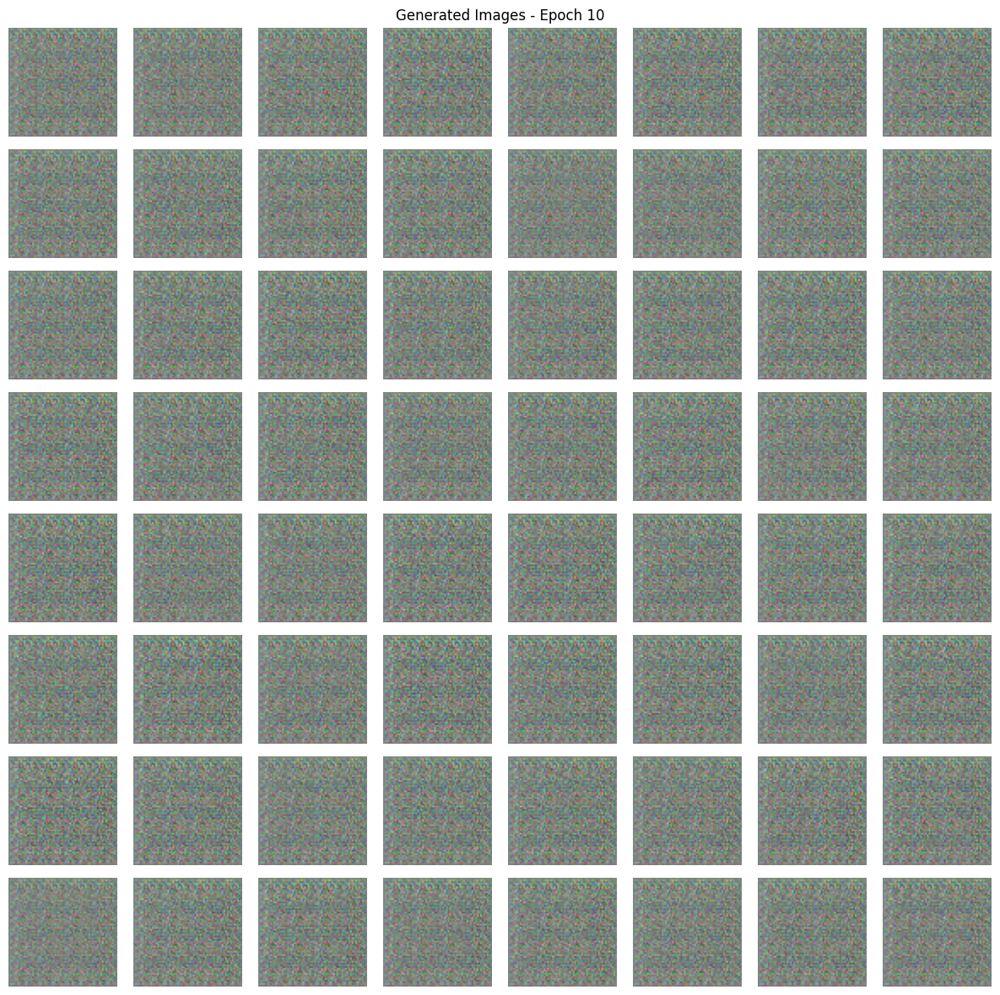

Epoch [11/100], Step [0/5], D Loss: 0.0541, G Loss: 13.7442
Epoch [11/100] - Avg G Loss: 16.5090, Avg D Loss: 0.3436
Epoch [12/100], Step [0/5], D Loss: 0.0619, G Loss: 14.8489
Epoch [12/100] - Avg G Loss: 12.4576, Avg D Loss: 0.1221
Epoch [13/100], Step [0/5], D Loss: 0.0371, G Loss: 12.3996
Epoch [13/100] - Avg G Loss: 23.1462, Avg D Loss: 0.7104
Epoch [14/100], Step [0/5], D Loss: 0.1397, G Loss: 35.4835
Epoch [14/100] - Avg G Loss: 35.4512, Avg D Loss: 0.0496
Epoch [15/100], Step [0/5], D Loss: 0.0207, G Loss: 35.1651
Epoch [15/100] - Avg G Loss: 35.3694, Avg D Loss: 0.0103
Epoch [16/100], Step [0/5], D Loss: 0.0072, G Loss: 34.9702
Epoch [16/100] - Avg G Loss: 34.9528, Avg D Loss: 0.0059
Epoch [17/100], Step [0/5], D Loss: 0.0024, G Loss: 34.5184
Epoch [17/100] - Avg G Loss: 34.1328, Avg D Loss: 0.0056
Epoch [18/100], Step [0/5], D Loss: 0.0041, G Loss: 33.6599
Epoch [18/100] - Avg G Loss: 32.1509, Avg D Loss: 0.0035
Epoch [19/100], Step [0/5], D Loss: 0.0025, G Loss: 27.2680
Epoc

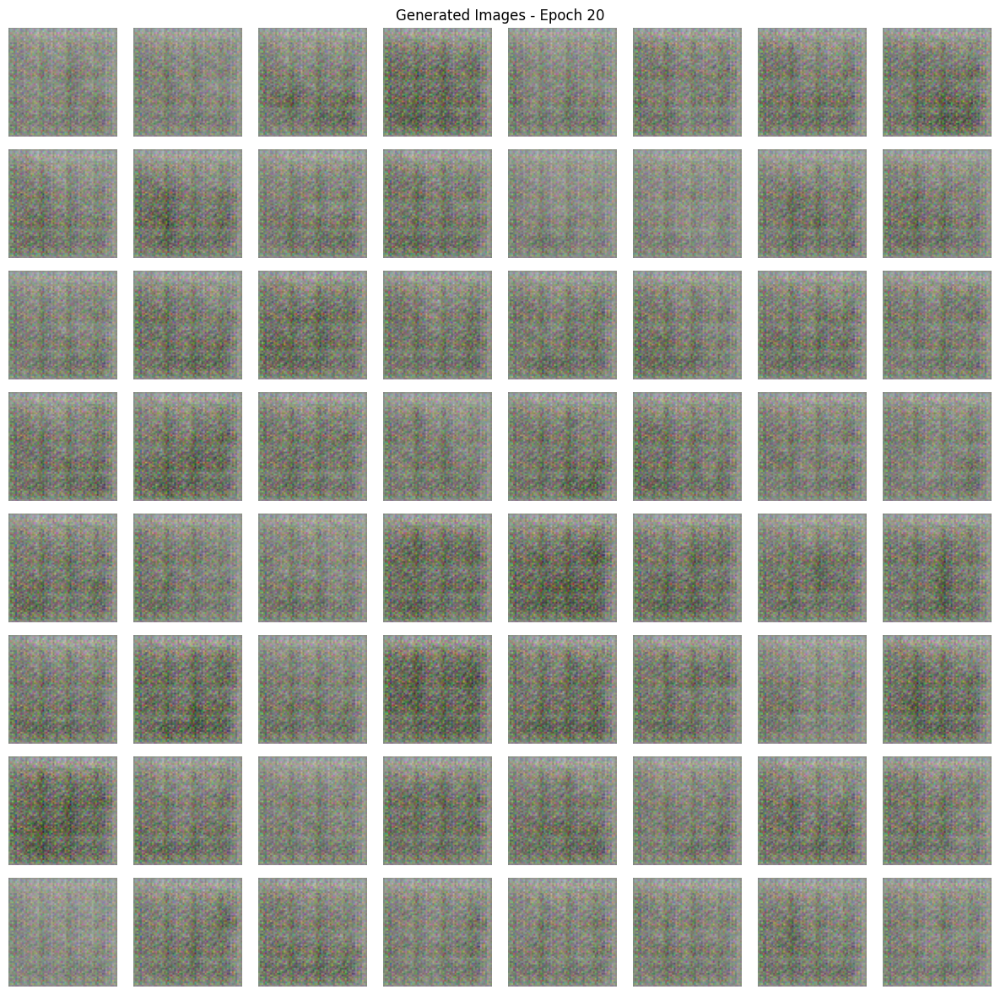

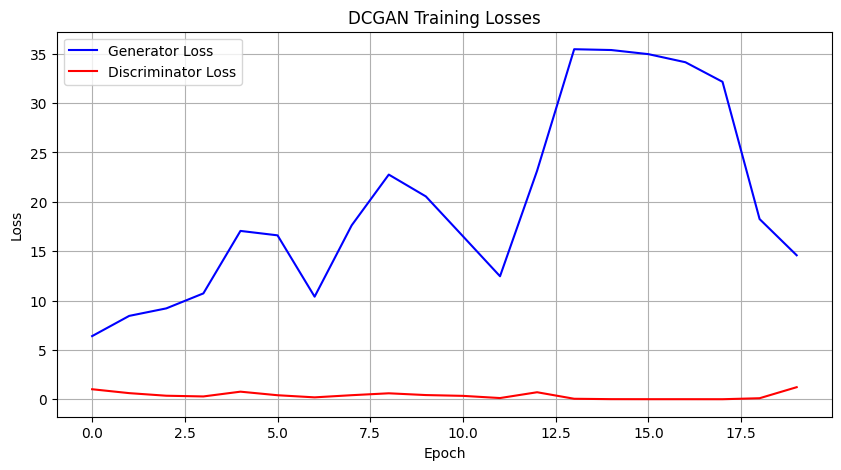

Epoch [21/100], Step [0/5], D Loss: 0.2857, G Loss: 5.3579
Epoch [21/100] - Avg G Loss: 11.2615, Avg D Loss: 1.7727
Epoch [22/100], Step [0/5], D Loss: 0.6274, G Loss: 8.4817
Epoch [22/100] - Avg G Loss: 8.2756, Avg D Loss: 0.8434
Epoch [23/100], Step [0/5], D Loss: 0.6478, G Loss: 7.3037
Epoch [23/100] - Avg G Loss: 5.8246, Avg D Loss: 0.5604
Epoch [24/100], Step [0/5], D Loss: 1.9500, G Loss: 10.1742
Epoch [24/100] - Avg G Loss: 5.9064, Avg D Loss: 1.3048
Epoch [25/100], Step [0/5], D Loss: 1.4186, G Loss: 10.4976
Epoch [25/100] - Avg G Loss: 5.3195, Avg D Loss: 1.3068
Epoch [26/100], Step [0/5], D Loss: 0.6048, G Loss: 2.9585
Epoch [26/100] - Avg G Loss: 3.7062, Avg D Loss: 0.7089
Epoch [27/100], Step [0/5], D Loss: 0.4734, G Loss: 3.0292
Epoch [27/100] - Avg G Loss: 4.1435, Avg D Loss: 0.9721
Epoch [28/100], Step [0/5], D Loss: 0.6542, G Loss: 2.4318
Epoch [28/100] - Avg G Loss: 3.1219, Avg D Loss: 0.7549
Epoch [29/100], Step [0/5], D Loss: 1.1603, G Loss: 6.3933
Epoch [29/100] - A

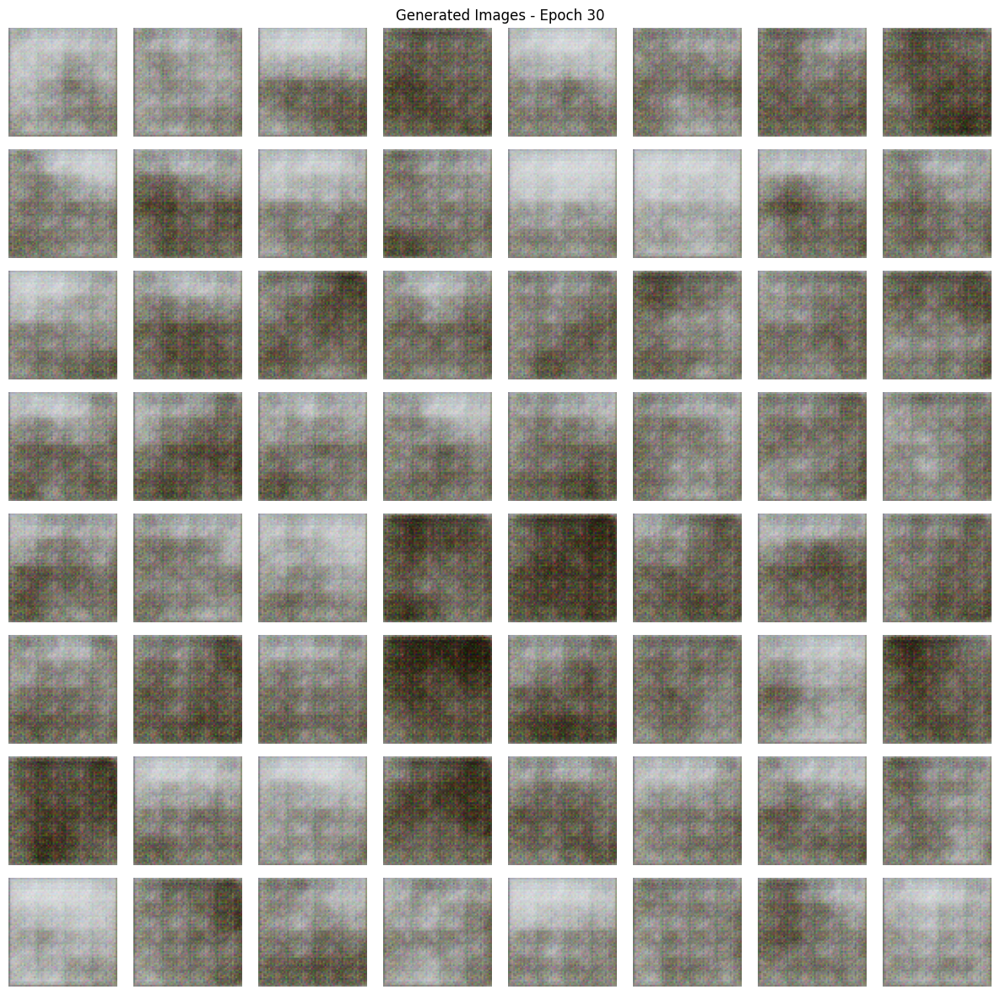

Epoch [31/100], Step [0/5], D Loss: 1.5977, G Loss: 5.7922
Epoch [31/100] - Avg G Loss: 4.3011, Avg D Loss: 1.0353
Epoch [32/100], Step [0/5], D Loss: 0.6017, G Loss: 3.9195
Epoch [32/100] - Avg G Loss: 3.5462, Avg D Loss: 0.6936
Epoch [33/100], Step [0/5], D Loss: 0.7818, G Loss: 4.1023
Epoch [33/100] - Avg G Loss: 4.1310, Avg D Loss: 0.6220
Epoch [34/100], Step [0/5], D Loss: 0.6134, G Loss: 5.7519
Epoch [34/100] - Avg G Loss: 4.4228, Avg D Loss: 0.6755
Epoch [35/100], Step [0/5], D Loss: 0.3091, G Loss: 4.6568
Epoch [35/100] - Avg G Loss: 4.2346, Avg D Loss: 0.4262
Epoch [36/100], Step [0/5], D Loss: 0.3326, G Loss: 4.3696
Epoch [36/100] - Avg G Loss: 4.6547, Avg D Loss: 0.4400
Epoch [37/100], Step [0/5], D Loss: 0.5543, G Loss: 5.9622
Epoch [37/100] - Avg G Loss: 4.9525, Avg D Loss: 0.3878
Epoch [38/100], Step [0/5], D Loss: 0.3375, G Loss: 5.4527
Epoch [38/100] - Avg G Loss: 5.2206, Avg D Loss: 0.3470
Epoch [39/100], Step [0/5], D Loss: 0.2711, G Loss: 4.8559
Epoch [39/100] - Avg 

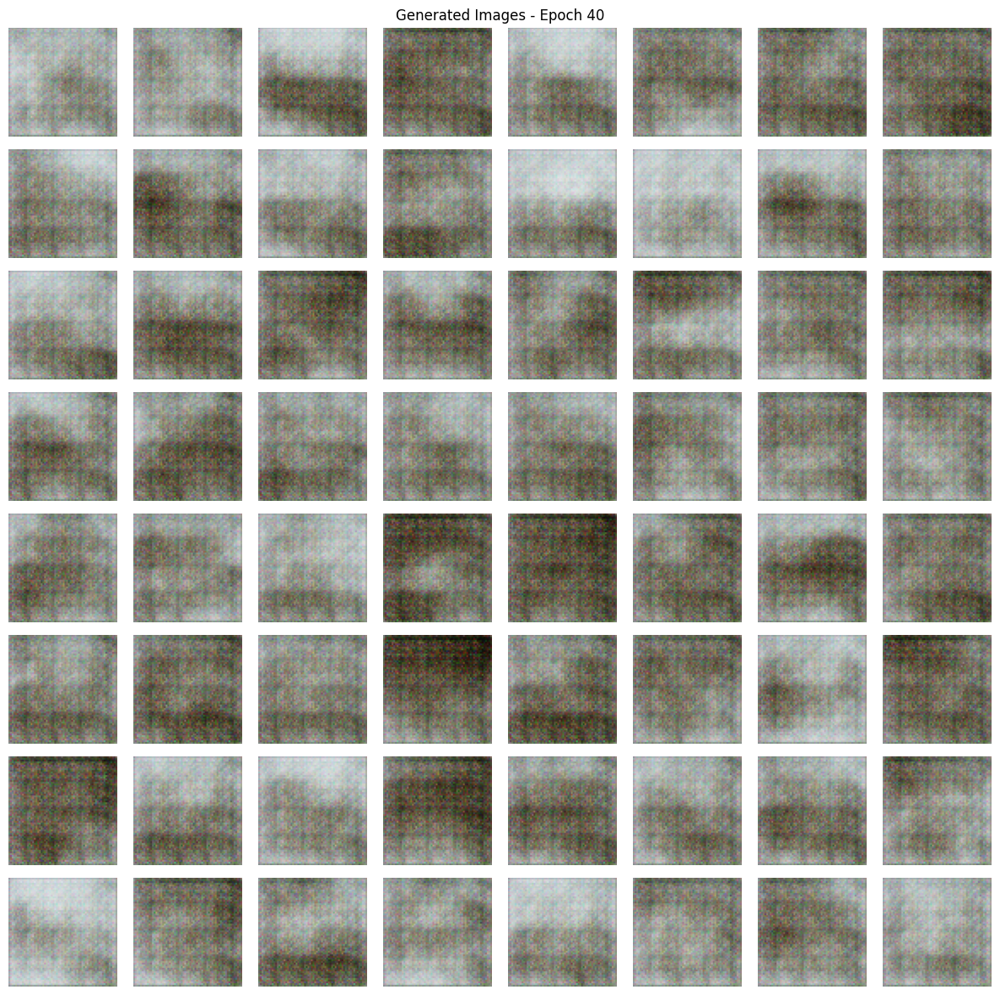

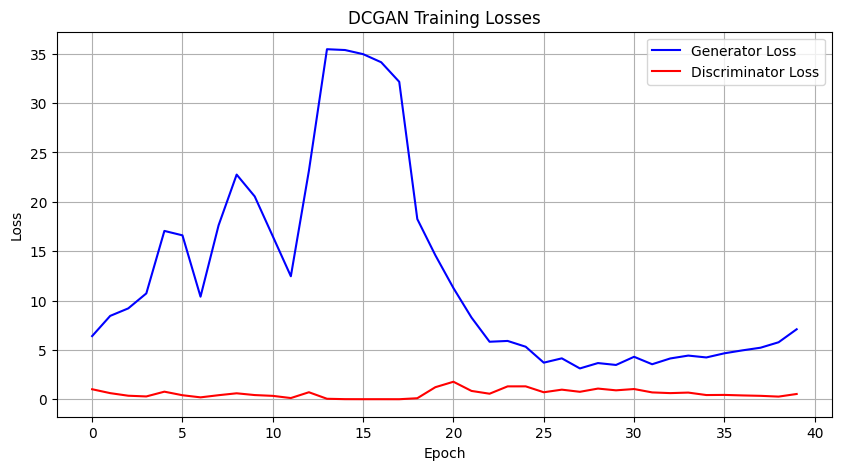

Epoch [41/100], Step [0/5], D Loss: 0.2129, G Loss: 4.9597
Epoch [41/100] - Avg G Loss: 5.5732, Avg D Loss: 0.2163
Epoch [42/100], Step [0/5], D Loss: 0.3773, G Loss: 5.6832
Epoch [42/100] - Avg G Loss: 5.3905, Avg D Loss: 0.2772
Epoch [43/100], Step [0/5], D Loss: 0.2566, G Loss: 5.6148
Epoch [43/100] - Avg G Loss: 5.3954, Avg D Loss: 0.2069
Epoch [44/100], Step [0/5], D Loss: 0.1351, G Loss: 5.4731
Epoch [44/100] - Avg G Loss: 5.7895, Avg D Loss: 0.1717
Epoch [45/100], Step [0/5], D Loss: 0.4715, G Loss: 10.6761
Epoch [45/100] - Avg G Loss: 12.3543, Avg D Loss: 0.6249
Epoch [46/100], Step [0/5], D Loss: 0.3300, G Loss: 11.2659
Epoch [46/100] - Avg G Loss: 12.0129, Avg D Loss: 0.7456
Epoch [47/100], Step [0/5], D Loss: 0.0544, G Loss: 6.6974
Epoch [47/100] - Avg G Loss: 8.4968, Avg D Loss: 0.4548
Epoch [48/100], Step [0/5], D Loss: 0.9143, G Loss: 11.7448
Epoch [48/100] - Avg G Loss: 7.7301, Avg D Loss: 0.4070
Epoch [49/100], Step [0/5], D Loss: 0.2825, G Loss: 5.2827
Epoch [49/100] -

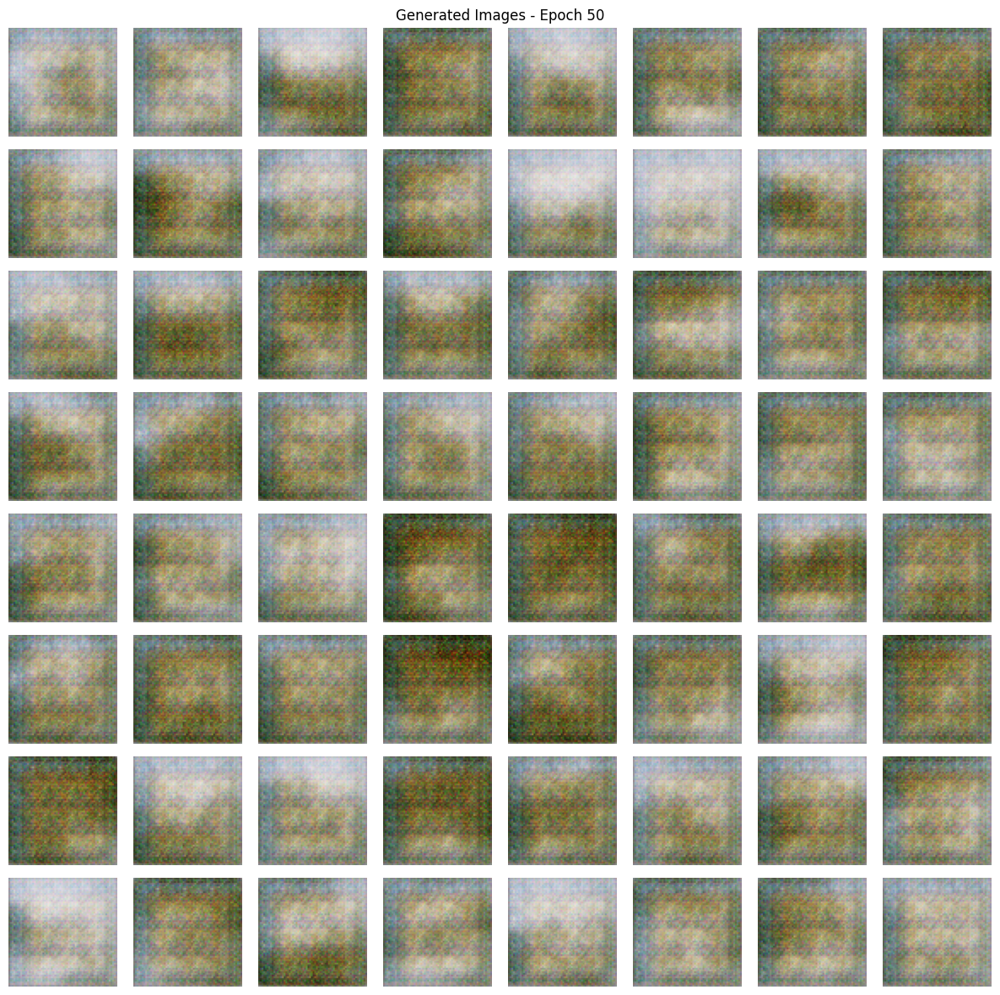

Epoch [51/100], Step [0/5], D Loss: 0.2916, G Loss: 5.5982
Epoch [51/100] - Avg G Loss: 5.6021, Avg D Loss: 0.2310
Epoch [52/100], Step [0/5], D Loss: 0.2435, G Loss: 6.8107
Epoch [52/100] - Avg G Loss: 6.4990, Avg D Loss: 0.7873
Epoch [53/100], Step [0/5], D Loss: 0.4894, G Loss: 9.1810
Epoch [53/100] - Avg G Loss: 7.4826, Avg D Loss: 0.3988
Epoch [54/100], Step [0/5], D Loss: 0.1817, G Loss: 5.2234
Epoch [54/100] - Avg G Loss: 5.2583, Avg D Loss: 0.1342
Epoch [55/100], Step [0/5], D Loss: 0.1843, G Loss: 5.4785
Epoch [55/100] - Avg G Loss: 6.4985, Avg D Loss: 0.2233
Epoch [56/100], Step [0/5], D Loss: 0.2921, G Loss: 5.9104
Epoch [56/100] - Avg G Loss: 6.3191, Avg D Loss: 0.2409
Epoch [57/100], Step [0/5], D Loss: 0.2493, G Loss: 5.5149
Epoch [57/100] - Avg G Loss: 6.9190, Avg D Loss: 0.3573
Epoch [58/100], Step [0/5], D Loss: 0.1450, G Loss: 6.3846
Epoch [58/100] - Avg G Loss: 10.5777, Avg D Loss: 0.5394
Epoch [59/100], Step [0/5], D Loss: 0.2489, G Loss: 5.9247
Epoch [59/100] - Avg

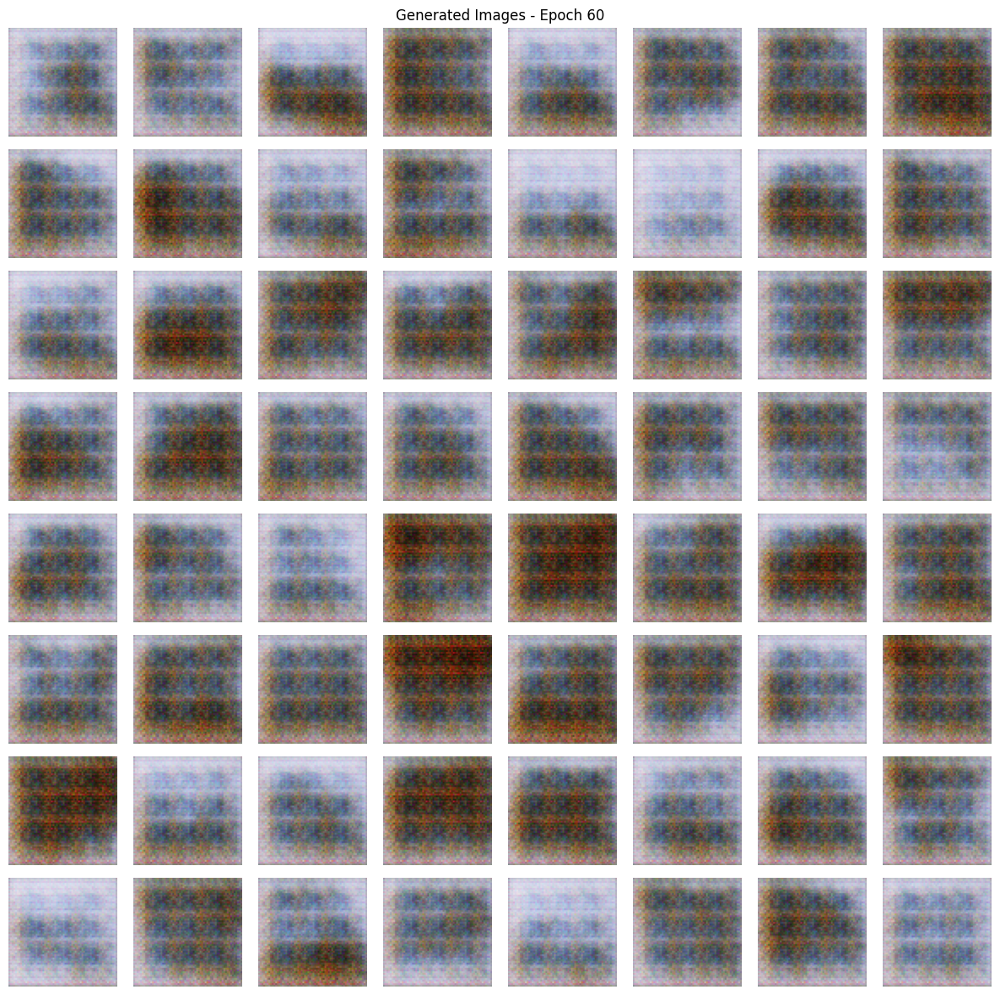

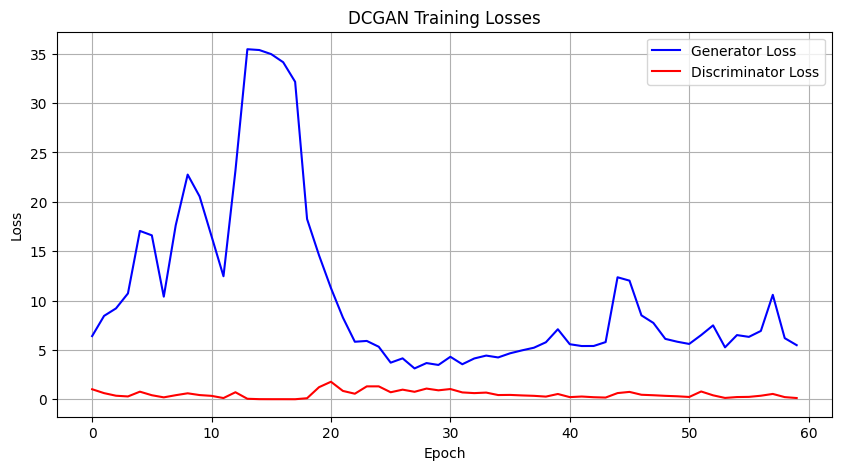

Epoch [61/100], Step [0/5], D Loss: 0.0863, G Loss: 5.7850
Epoch [61/100] - Avg G Loss: 5.5376, Avg D Loss: 0.0969
Epoch [62/100], Step [0/5], D Loss: 0.1863, G Loss: 4.4032
Epoch [62/100] - Avg G Loss: 5.8203, Avg D Loss: 0.2251
Epoch [63/100], Step [0/5], D Loss: 0.1229, G Loss: 6.5230
Epoch [63/100] - Avg G Loss: 5.3930, Avg D Loss: 0.1796
Epoch [64/100], Step [0/5], D Loss: 0.1440, G Loss: 5.2082
Epoch [64/100] - Avg G Loss: 4.9945, Avg D Loss: 0.1725
Epoch [65/100], Step [0/5], D Loss: 0.1787, G Loss: 5.3247
Epoch [65/100] - Avg G Loss: 5.2438, Avg D Loss: 0.4069
Epoch [66/100], Step [0/5], D Loss: 0.4590, G Loss: 6.3681
Epoch [66/100] - Avg G Loss: 5.5160, Avg D Loss: 0.2786
Epoch [67/100], Step [0/5], D Loss: 0.2190, G Loss: 5.4048
Epoch [67/100] - Avg G Loss: 5.0958, Avg D Loss: 0.2194
Epoch [68/100], Step [0/5], D Loss: 0.1142, G Loss: 6.0534
Epoch [68/100] - Avg G Loss: 5.2773, Avg D Loss: 0.1900
Epoch [69/100], Step [0/5], D Loss: 0.4677, G Loss: 10.1357
Epoch [69/100] - Avg

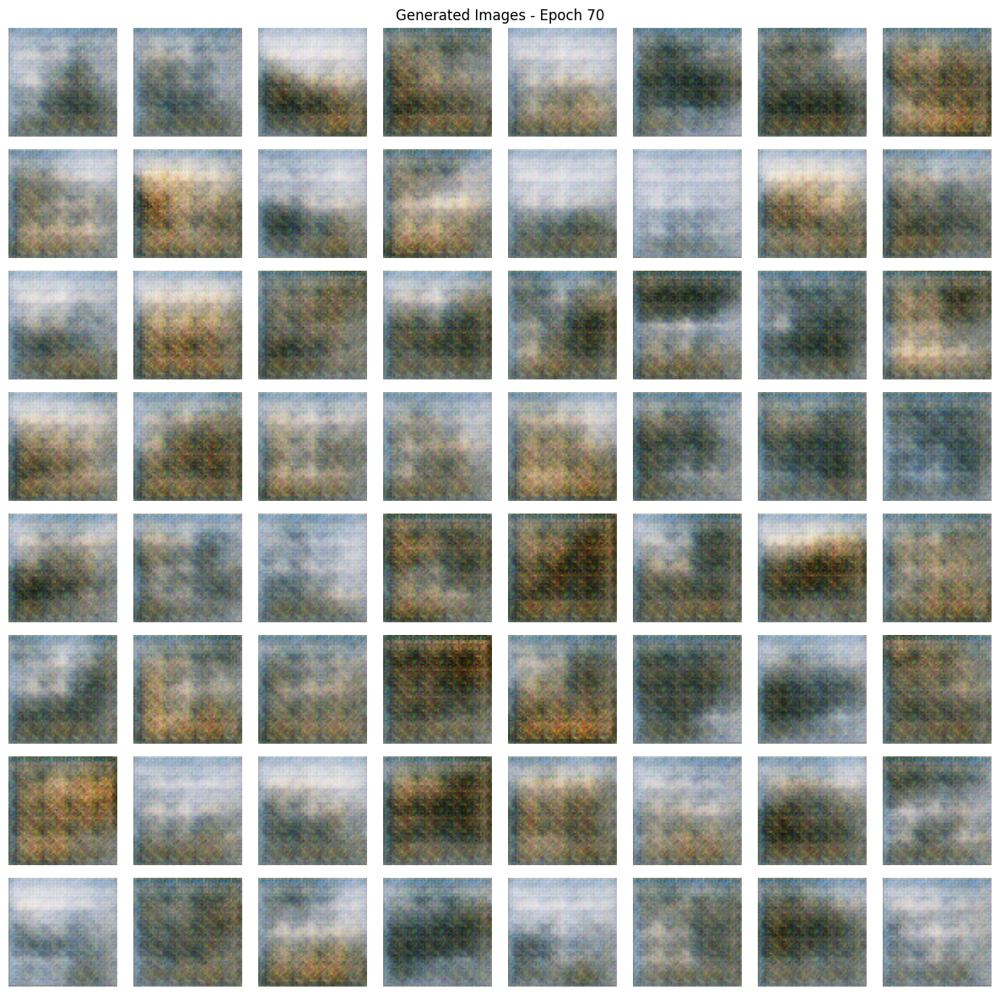

Epoch [71/100], Step [0/5], D Loss: 0.6271, G Loss: 2.3640
Epoch [71/100] - Avg G Loss: 3.6020, Avg D Loss: 0.9565
Epoch [72/100], Step [0/5], D Loss: 0.4007, G Loss: 3.9265
Epoch [72/100] - Avg G Loss: 3.3865, Avg D Loss: 0.6166
Epoch [73/100], Step [0/5], D Loss: 1.6473, G Loss: 7.3161
Epoch [73/100] - Avg G Loss: 3.5694, Avg D Loss: 1.4174
Epoch [74/100], Step [0/5], D Loss: 1.0276, G Loss: 4.4496
Epoch [74/100] - Avg G Loss: 3.2070, Avg D Loss: 0.8148
Epoch [75/100], Step [0/5], D Loss: 0.7784, G Loss: 2.9580
Epoch [75/100] - Avg G Loss: 3.3316, Avg D Loss: 0.7421
Epoch [76/100], Step [0/5], D Loss: 0.6427, G Loss: 3.4641
Epoch [76/100] - Avg G Loss: 3.2813, Avg D Loss: 0.7615
Epoch [77/100], Step [0/5], D Loss: 1.5574, G Loss: 5.2709
Epoch [77/100] - Avg G Loss: 3.5886, Avg D Loss: 0.9607
Epoch [78/100], Step [0/5], D Loss: 1.1157, G Loss: 5.1625
Epoch [78/100] - Avg G Loss: 3.6945, Avg D Loss: 1.3076
Epoch [79/100], Step [0/5], D Loss: 0.8546, G Loss: 2.9951
Epoch [79/100] - Avg 

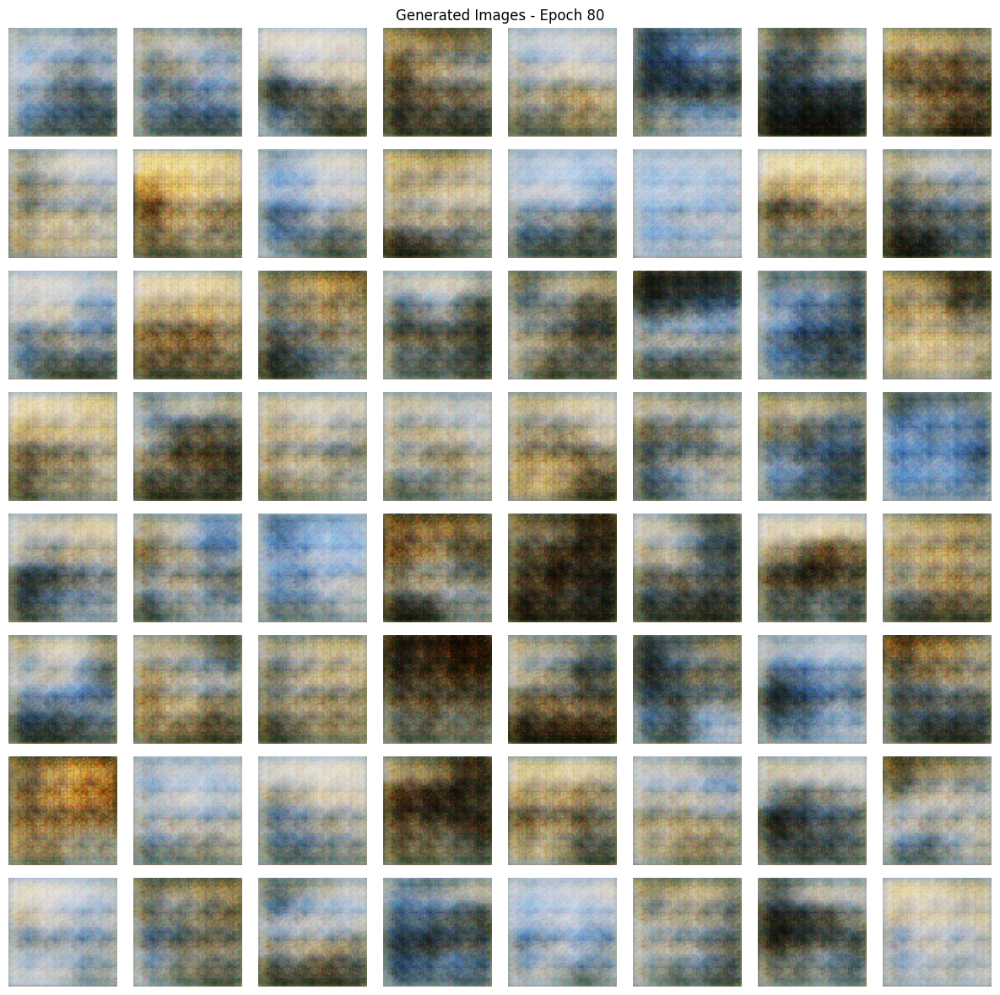

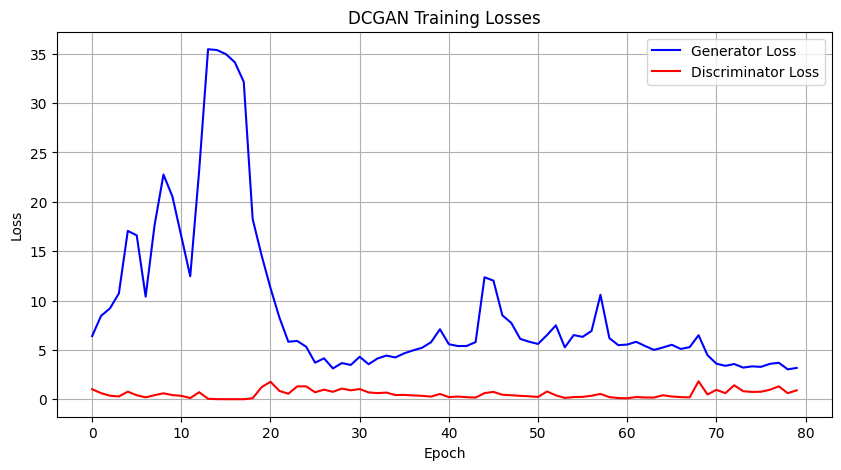

Epoch [81/100], Step [0/5], D Loss: 0.5066, G Loss: 3.3107
Epoch [81/100] - Avg G Loss: 3.4552, Avg D Loss: 0.5687
Epoch [82/100], Step [0/5], D Loss: 1.0081, G Loss: 2.7520
Epoch [82/100] - Avg G Loss: 3.2025, Avg D Loss: 0.5687
Epoch [83/100], Step [0/5], D Loss: 0.9312, G Loss: 4.1229
Epoch [83/100] - Avg G Loss: 4.0923, Avg D Loss: 1.2874
Epoch [84/100], Step [0/5], D Loss: 1.5880, G Loss: 2.1471
Epoch [84/100] - Avg G Loss: 2.9334, Avg D Loss: 0.8836
Epoch [85/100], Step [0/5], D Loss: 0.4726, G Loss: 3.2871
Epoch [85/100] - Avg G Loss: 3.3157, Avg D Loss: 0.4182
Epoch [86/100], Step [0/5], D Loss: 0.4477, G Loss: 2.8889
Epoch [86/100] - Avg G Loss: 3.4330, Avg D Loss: 0.4251
Epoch [87/100], Step [0/5], D Loss: 0.4188, G Loss: 4.3992
Epoch [87/100] - Avg G Loss: 4.0665, Avg D Loss: 0.3720
Epoch [88/100], Step [0/5], D Loss: 0.3921, G Loss: 4.1780
Epoch [88/100] - Avg G Loss: 4.3596, Avg D Loss: 0.4228
Epoch [89/100], Step [0/5], D Loss: 0.5301, G Loss: 3.5819
Epoch [89/100] - Avg 

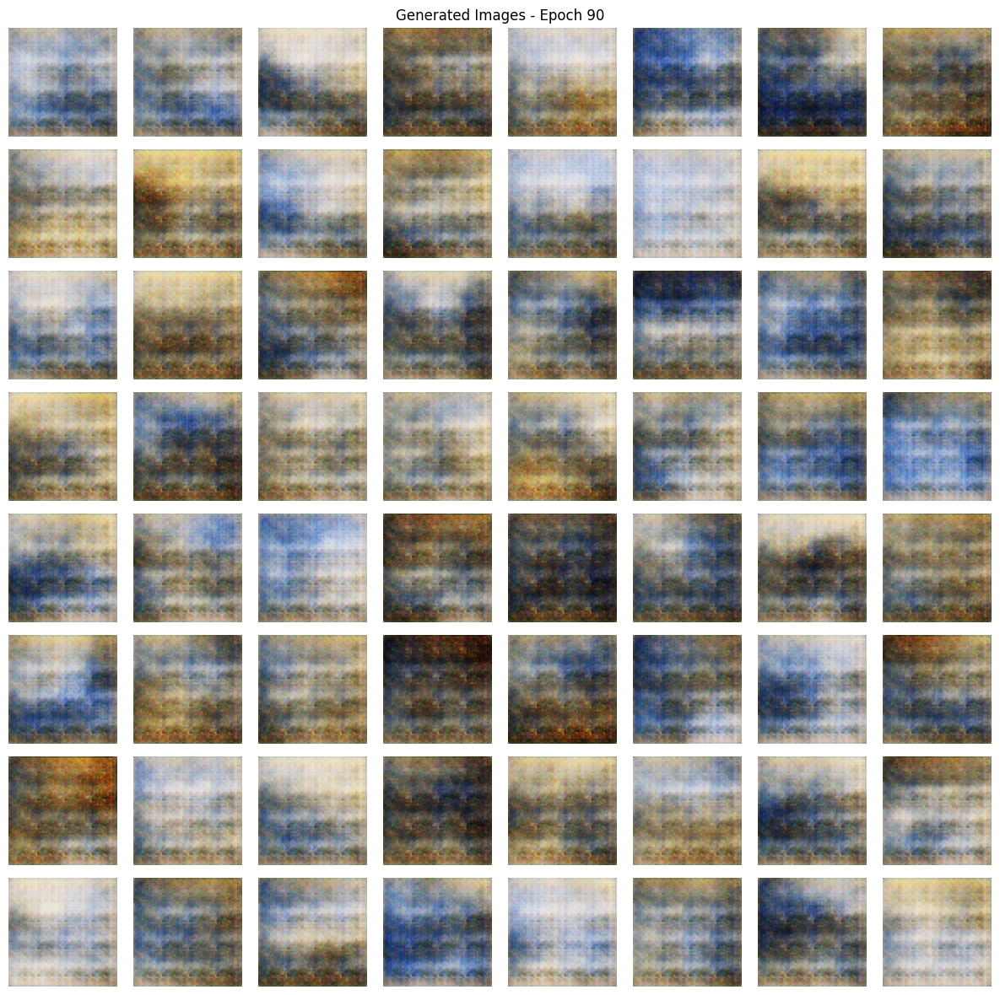

Epoch [91/100], Step [0/5], D Loss: 0.3296, G Loss: 3.7693
Epoch [91/100] - Avg G Loss: 4.0690, Avg D Loss: 0.4437
Epoch [92/100], Step [0/5], D Loss: 0.4744, G Loss: 3.5942
Epoch [92/100] - Avg G Loss: 3.3789, Avg D Loss: 0.7061
Epoch [93/100], Step [0/5], D Loss: 1.0698, G Loss: 5.8115
Epoch [93/100] - Avg G Loss: 3.3173, Avg D Loss: 1.3287
Epoch [94/100], Step [0/5], D Loss: 0.6348, G Loss: 3.4914
Epoch [94/100] - Avg G Loss: 3.1320, Avg D Loss: 0.5547
Epoch [95/100], Step [0/5], D Loss: 0.6778, G Loss: 5.6304
Epoch [95/100] - Avg G Loss: 3.8372, Avg D Loss: 0.6031
Epoch [96/100], Step [0/5], D Loss: 0.5929, G Loss: 5.6867
Epoch [96/100] - Avg G Loss: 4.6920, Avg D Loss: 0.3438
Epoch [97/100], Step [0/5], D Loss: 0.2804, G Loss: 3.7702
Epoch [97/100] - Avg G Loss: 4.8412, Avg D Loss: 0.3637
Epoch [98/100], Step [0/5], D Loss: 0.1005, G Loss: 5.3183
Epoch [98/100] - Avg G Loss: 4.7526, Avg D Loss: 0.2851
Epoch [99/100], Step [0/5], D Loss: 0.4635, G Loss: 5.8302
Epoch [99/100] - Avg 

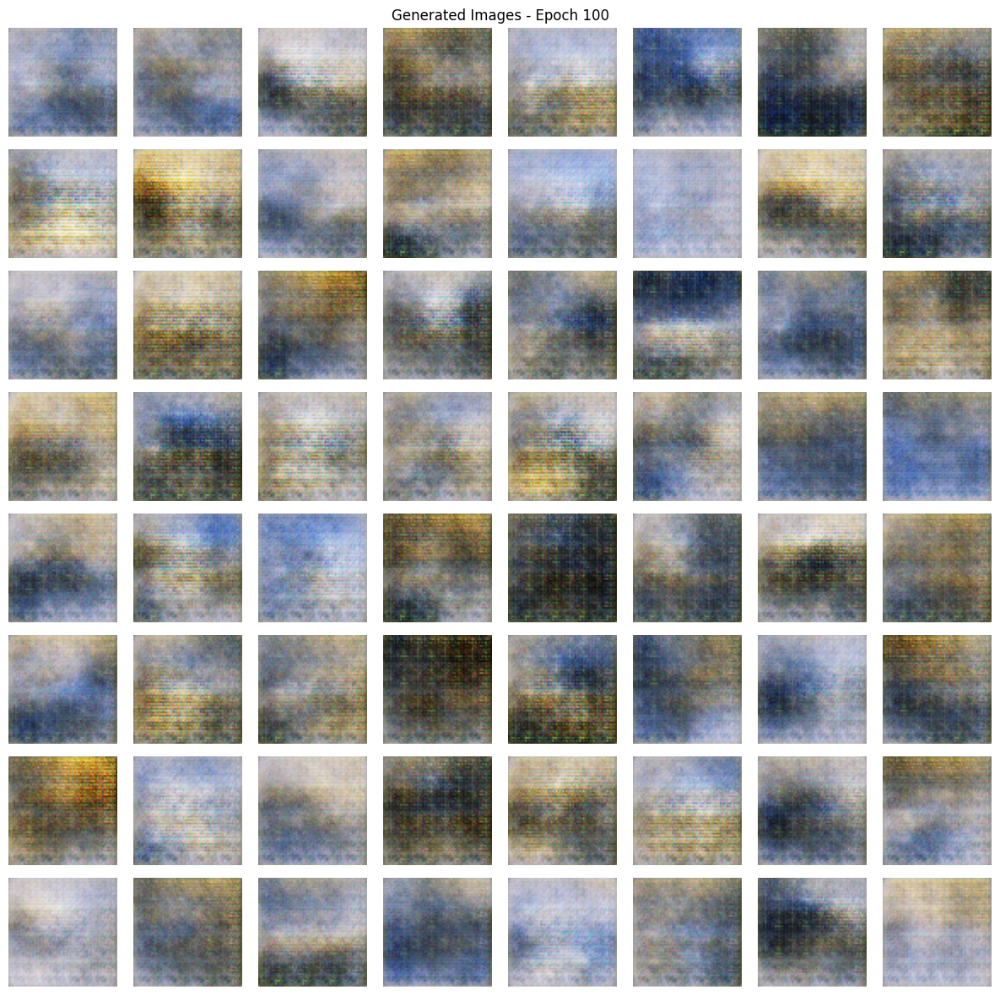

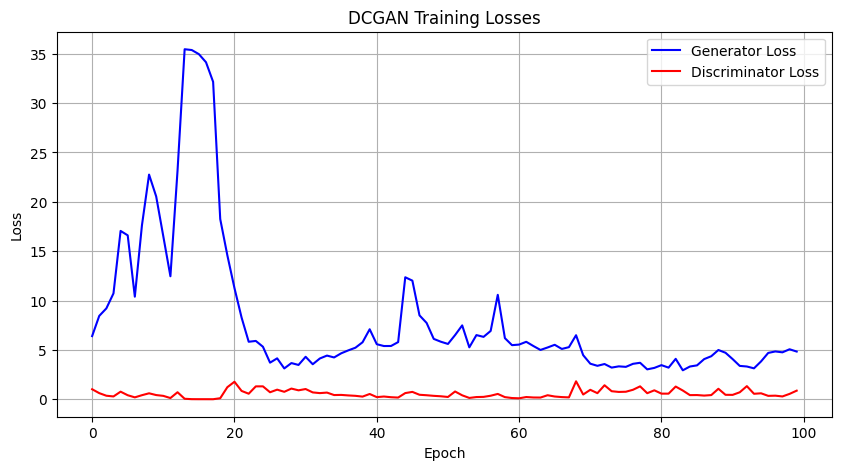

Evaluating final results...


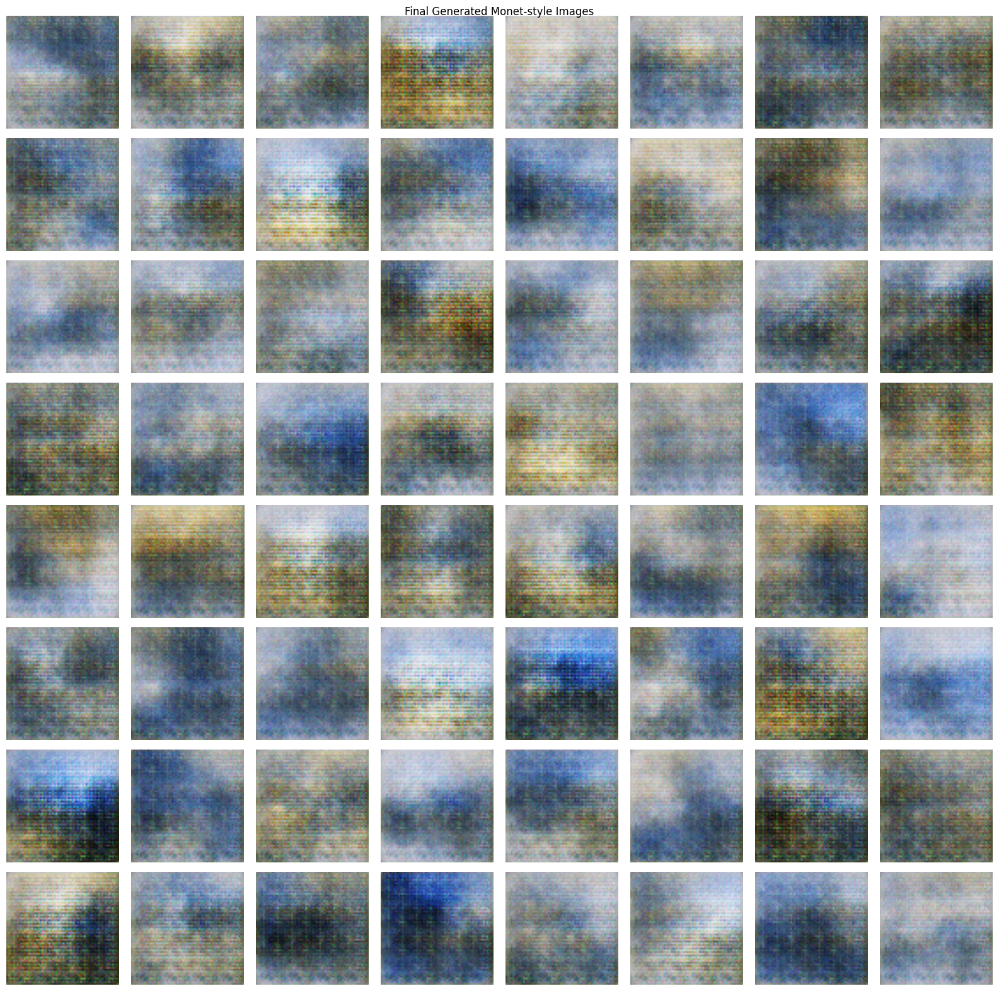

Models saved!


In [8]:
# Add missing import
from PIL import Image
from torchvision.utils import save_image

# Update your transform to resize to 64x64 for DCGAN
transform = transforms.Compose([
    transforms.Resize((64, 64)),  # DCGAN works with 64x64 images
    transforms.ToTensor(),
    transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])  # Normalize to [-1, 1]
])

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Create dataset and dataloader
monet_dataset = MonetDataset(monet_paths, transform=transform)
dataloader = DataLoader(monet_dataset, batch_size=64, shuffle=True, num_workers=2)

print(f"Dataset size: {len(monet_dataset)}")
print(f"Number of batches: {len(dataloader)}")

# Test one batch
sample_batch = next(iter(dataloader))
print(f"Batch shape: {sample_batch.shape}")

# Initialize models
latent_dim = 100
generator = DCGANGenerator(latent_dim=latent_dim).to(device)
discriminator = DCGANDiscriminator().to(device)

print(f"Generator parameters: {sum(p.numel() for p in generator.parameters()):,}")
print(f"Discriminator parameters: {sum(p.numel() for p in discriminator.parameters()):,}")

# Weight initialization function (important for DCGAN)
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Apply weight initialization
generator.apply(weights_init)
discriminator.apply(weights_init)

# Loss function and optimizers
criterion = nn.BCELoss()
optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Training function with monitoring
def train_dcgan(generator, discriminator, dataloader, num_epochs=100):
    g_losses = []
    d_losses = []

    # Fixed noise for consistent sample generation
    fixed_noise = torch.randn(64, latent_dim, 1, 1).to(device)

    for epoch in range(num_epochs):
        epoch_g_loss = 0
        epoch_d_loss = 0
        num_batches = 0

        for i, real_imgs in enumerate(dataloader):
            real_imgs = real_imgs.to(device)
            batch_size = real_imgs.size(0)

            # Create labels
            real_labels = torch.ones(batch_size).to(device)
            fake_labels = torch.zeros(batch_size).to(device)

            # =====================
            # Train Discriminator
            # =====================
            optimizer_D.zero_grad()

            # Train with real images
            output_real = discriminator(real_imgs)
            loss_D_real = criterion(output_real, real_labels)

            # Train with fake images
            noise = torch.randn(batch_size, latent_dim, 1, 1).to(device)
            fake_imgs = generator(noise)
            output_fake = discriminator(fake_imgs.detach())
            loss_D_fake = criterion(output_fake, fake_labels)

            # Total discriminator loss
            loss_D = loss_D_real + loss_D_fake
            loss_D.backward()
            optimizer_D.step()

            # =====================
            # Train Generator
            # =====================
            optimizer_G.zero_grad()

            # Generate fake images and get discriminator's opinion
            output_fake = discriminator(fake_imgs)
            loss_G = criterion(output_fake, real_labels)  # Want discriminator to think fake is real
            loss_G.backward()
            optimizer_G.step()

            # Track losses
            epoch_g_loss += loss_G.item()
            epoch_d_loss += loss_D.item()
            num_batches += 1

            # Print progress
            if i % 50 == 0:
                print(f'Epoch [{epoch+1}/{num_epochs}], Step [{i}/{len(dataloader)}], '
                      f'D Loss: {loss_D.item():.4f}, G Loss: {loss_G.item():.4f}')

        # Calculate average losses for the epoch
        avg_g_loss = epoch_g_loss / num_batches
        avg_d_loss = epoch_d_loss / num_batches
        g_losses.append(avg_g_loss)
        d_losses.append(avg_d_loss)

        print(f'Epoch [{epoch+1}/{num_epochs}] - Avg G Loss: {avg_g_loss:.4f}, Avg D Loss: {avg_d_loss:.4f}')

        # Generate sample images every 10 epochs
        if (epoch + 1) % 10 == 0:
            with torch.no_grad():
                fake_samples = generator(fixed_noise)

                # Visualize samples
                fig, axes = plt.subplots(8, 8, figsize=(12, 12))
                for idx, ax in enumerate(axes.flatten()):
                    img = fake_samples[idx].cpu()
                    img = (img + 1) / 2  # Denormalize from [-1,1] to [0,1]
                    ax.imshow(img.permute(1, 2, 0))
                    ax.axis('off')
                plt.suptitle(f'Generated Images - Epoch {epoch+1}')
                plt.tight_layout()
                plt.show()

        # Plot loss curves every 20 epochs
        if (epoch + 1) % 20 == 0:
            plt.figure(figsize=(10, 5))
            plt.plot(g_losses, label='Generator Loss', color='blue')
            plt.plot(d_losses, label='Discriminator Loss', color='red')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend()
            plt.title('DCGAN Training Losses')
            plt.grid(True)
            plt.show()

    return g_losses, d_losses

# Start training
print("Starting DCGAN training...")
g_losses, d_losses = train_dcgan(generator, discriminator, dataloader, num_epochs=100)

# Final evaluation
def evaluate_dcgan(generator, num_samples=64):
    generator.eval()
    with torch.no_grad():
        noise = torch.randn(num_samples, latent_dim, 1, 1).to(device)
        fake_imgs = generator(noise)

        # Create grid visualization
        fig, axes = plt.subplots(8, 8, figsize=(16, 16))
        for idx, ax in enumerate(axes.flatten()):
            img = fake_imgs[idx].cpu()
            img = (img + 1) / 2  # Denormalize
            ax.imshow(img.permute(1, 2, 0))
            ax.axis('off')
        plt.suptitle('Final Generated Monet-style Images')
        plt.tight_layout()
        plt.show()

print("Evaluating final results...")
evaluate_dcgan(generator)

# Save models
torch.save(generator.state_dict(), 'dcgan_generator.pth')
torch.save(discriminator.state_dict(), 'dcgan_discriminator.pth')
print("Models saved!")
